In [20]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [21]:
file = pd.read_csv('D:\\datasets\\games analyze\\vgsales.csv')
df = file.copy()
df.sample(10)

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
13992,13994,Rhapsody: A Musical Adventure,PS,1998.0,Role-Playing,Nippon Ichi Software,0.02,0.01,0.00,0.00,0.04
12836,12838,IL-2 Sturmovik: Cliffs of Dover,PC,2011.0,Simulation,Ubisoft,0.00,0.04,0.00,0.01,0.05
16532,16535,STORM: Frontline Nation,PC,2011.0,Strategy,Unknown,0.00,0.01,0.00,0.00,0.01
3058,3060,Tiger Woods PGA Tour 2000,PS,1998.0,Sports,Electronic Arts,0.37,0.25,0.00,0.04,0.66
4340,4342,World Stadium 2,PS,1998.0,Sports,Namco Bandai Games,0.00,0.00,0.42,0.03,0.45
4166,4168,ICO,PS2,2001.0,Action,Sony Computer Entertainment,0.23,0.18,0.00,0.06,0.47
13414,13416,Yoru no Nai Kuni,PS3,2015.0,Role-Playing,Tecmo Koei,0.00,0.00,0.05,0.00,0.05
14918,14921,Puppet Show 3: Lost Town,PC,2011.0,Puzzle,Focus Home Interactive,0.00,0.02,0.00,0.00,0.02
6145,6147,Polaris,2600,1982.0,Action,Tigervision,0.26,0.02,0.00,0.00,0.28
3971,3973,Babysitting Mama,Wii,2010.0,Simulation,505 Games,0.34,0.12,0.00,0.04,0.50


In [22]:
from_year = int(min(df['Year']))
to_year = int(max(df['Year']))
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16598 entries, 0 to 16597
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rank          16598 non-null  int64  
 1   Name          16598 non-null  object 
 2   Platform      16598 non-null  object 
 3   Year          16327 non-null  float64
 4   Genre         16598 non-null  object 
 5   Publisher     16540 non-null  object 
 6   NA_Sales      16598 non-null  float64
 7   EU_Sales      16598 non-null  float64
 8   JP_Sales      16598 non-null  float64
 9   Other_Sales   16598 non-null  float64
 10  Global_Sales  16598 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 1.4+ MB


In [23]:
df.isnull().sum()

Rank              0
Name              0
Platform          0
Year            271
Genre             0
Publisher        58
NA_Sales          0
EU_Sales          0
JP_Sales          0
Other_Sales       0
Global_Sales      0
dtype: int64

In [24]:
pub = df['Publisher'].to_numpy().reshape(-1,1)
year = df['Year'].to_numpy().reshape(-1,1)
df = df.drop(['Publisher','Year'],axis=1)

In [25]:
from sklearn.impute import SimpleImputer
imputer = SimpleImputer(missing_values=np.nan,strategy='constant',fill_value='!')
imputer2 = SimpleImputer(missing_values=np.nan,strategy='constant',fill_value=0)
imputed_pub = pd.DataFrame(imputer.fit_transform(pub),columns=['publisher'])
imputed_y = pd.DataFrame(imputer2.fit_transform(year),columns=['Year'])

In [26]:
df = pd.concat([df,imputed_pub,imputed_y],axis=1)
nan_idx = df[df['publisher']=='!'].index
nan_y_idx = df[df['Year']==0].index
finall_df = df.drop(index=nan_idx,axis=0) 
finall_df = df.drop(index=nan_y_idx,axis=0)
finall_df.drop_duplicates()
finall_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16327 entries, 0 to 16597
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Rank          16327 non-null  int64  
 1   Name          16327 non-null  object 
 2   Platform      16327 non-null  object 
 3   Genre         16327 non-null  object 
 4   NA_Sales      16327 non-null  float64
 5   EU_Sales      16327 non-null  float64
 6   JP_Sales      16327 non-null  float64
 7   Other_Sales   16327 non-null  float64
 8   Global_Sales  16327 non-null  float64
 9   publisher     16327 non-null  object 
 10  Year          16327 non-null  float64
dtypes: float64(6), int64(1), object(4)
memory usage: 1.5+ MB


In [27]:
finall_df.describe()

,Rank,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Year
count,16327.000000,16327.000000,16327.000000,16327.000000,16327.000000,16327.000000,16327.000000
mean,8292.868194,0.265415,0.147554,0.078661,0.048325,0.540232,2006.406443
std,4792.669778,0.821591,0.508766,0.311557,0.189885,1.565732,5.828981
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.010000,1980.000000
25%,4136.500000,0.000000,0.000000,0.000000,0.000000,0.060000,2003.000000
50%,8295.000000,0.080000,0.020000,0.000000,0.010000,0.170000,2007.000000
75%,12441.500000,0.240000,0.110000,0.040000,0.040000,0.480000,2010.000000
max,16600.000000,41.490000,29.020000,10.220000,10.570000,82.740000,2020.000000


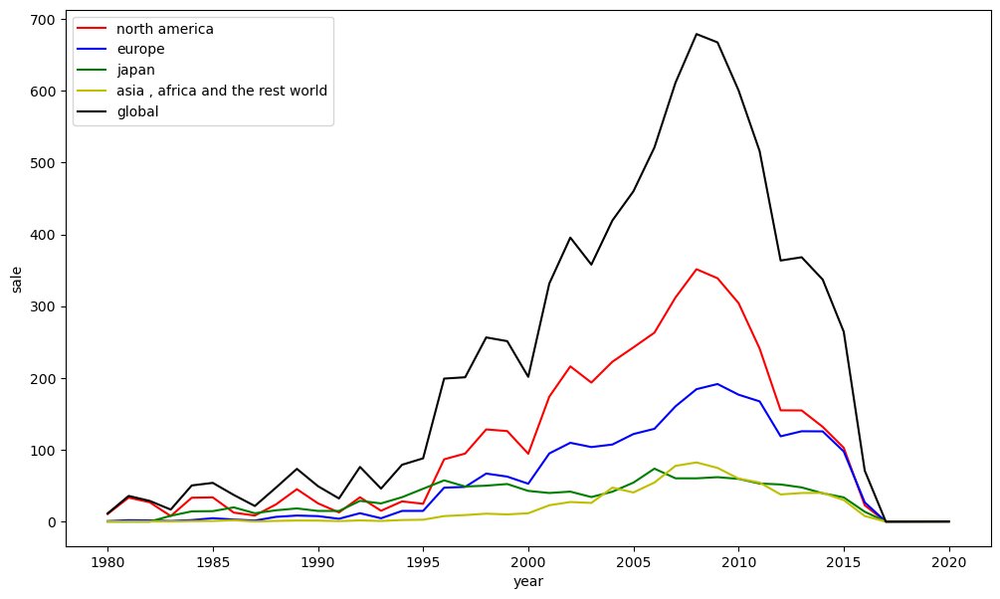

In [28]:
#total sales of all games over time by a plot
NA = list()
EU = list()
JP = list()
other =list()
gl = list()
x = list(set(finall_df['Year']))
for i in x :
    temp_df = finall_df[finall_df['Year']==i]
    NA.append(sum(temp_df['NA_Sales']))
    EU.append(sum(temp_df['EU_Sales']))
    JP.append(sum(temp_df['JP_Sales']))
    other.append(sum(temp_df['Other_Sales']))
    gl.append(sum(temp_df['Global_Sales']))
plt.figure(figsize=(12,7))
plt.plot(x,NA,'r')
plt.plot(x,EU,'blue')
plt.plot(x,JP,'g')
plt.plot(x,other,'y')
plt.plot(x,gl,'black')
plt.xlabel('year')
plt.ylabel('sale')
plt.legend(['north america','europe','japan','asia , africa and the rest world','global'])
plt.show()

In [29]:
#finding most famous games by global sales
games_name = list()
games_sale = list()
for name in set(finall_df['Name'].to_list()) :
    temp_df = finall_df[finall_df['Name']==name]
    sale = 0
    for j in temp_df['Global_Sales'] :
        sale+=j
    games_name.append((name,sale))
    games_sale.append((sale))
print('most famous games are :')
Max = max(games_sale)
for i in games_name :
    if i[1] == Max :
        print(f'{i[0]} with {int(i[1])} global sales in million from {from_year} to {to_year}')

most famous games are :
Wii Sports with 82 global sales in million from 1980 to 2020


In [30]:
#finding most famous Platform by global sales
games_name = list()
games_sale = list()
for name in set(finall_df['Platform'].to_list()) :
    temp_df = finall_df[finall_df['Platform']==name]
    sale = 0
    for j in temp_df['Global_Sales'] :
        sale+=j
    games_name.append((name,sale))
    games_sale.append((sale))
print('most famous Platform are :')
Max = max(games_sale)
for i in games_name :
    if i[1] == Max :
        print(f'{i[0]} with {int(i[1])} global sales in million from {from_year} to {to_year}')

most famous Platform are :
PS2 with 1233 global sales in million from 1980 to 2020


In [31]:
#finding most famous Genre by global sales
games_name = list()
games_sale = list()
for name in set(finall_df['Genre'].to_list()) :
    temp_df = finall_df[finall_df['Genre']==name]
    sale = 0
    for j in temp_df['Global_Sales'] :
        sale+=j
    games_name.append((name,sale))
    games_sale.append((sale))
print('most famous Genre are :')
Max = max(games_sale)
for i in games_name :
    if i[1] == Max :
        print(f'{i[0]} with {int(i[1])} global sales in million from {from_year} to {to_year}')

most famous Genre are :
Action with 1722 global sales in million from 1980 to 2020


In [32]:
#finding most famous Publisher by global sales
games_name = list()
games_sale = list()
for name in set(finall_df['publisher'].to_list()) :
    temp_df = finall_df[finall_df['publisher']==name]
    sale = 0
    for j in temp_df['Global_Sales'] :
        sale+=j
    games_name.append((name,sale))
    games_sale.append((sale))
print('most famous Publisher are :')
Max = max(games_sale)
for i in games_name :
    if i[1] == Max :
        print(f'{i[0]} with {int(i[1])} global sales in million from {from_year} to {to_year}')

most famous Publisher are :
Nintendo with 1784 global sales in million from 1980 to 2020


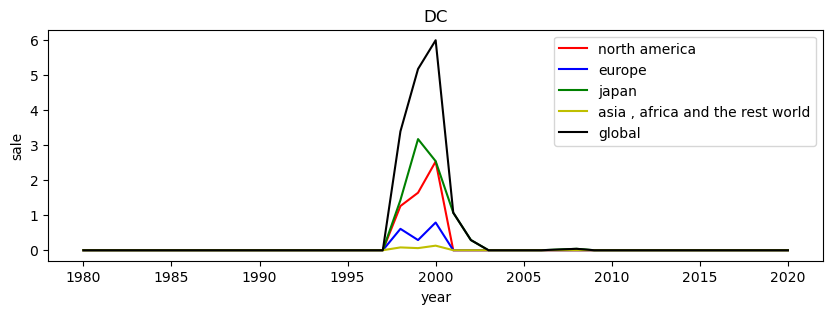

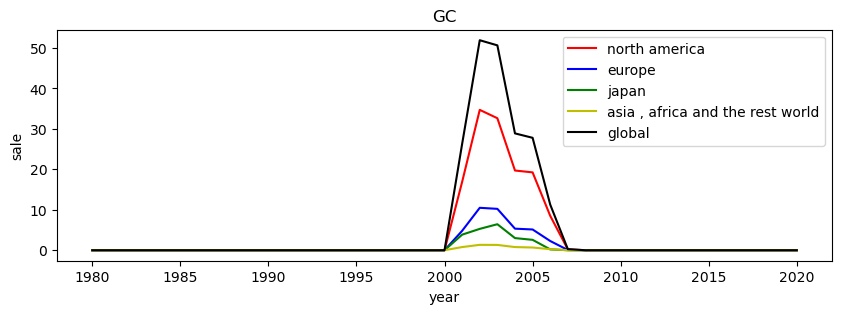

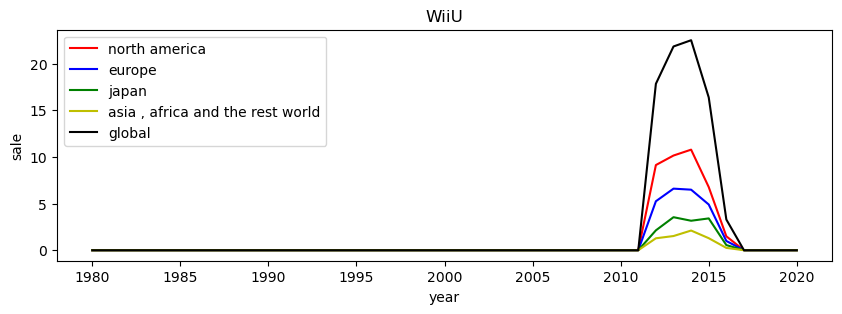

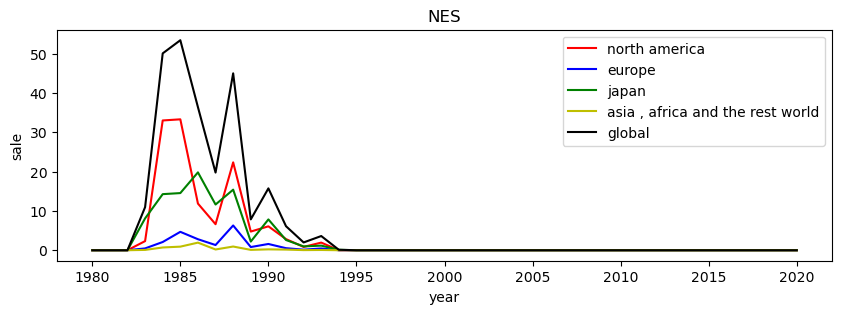

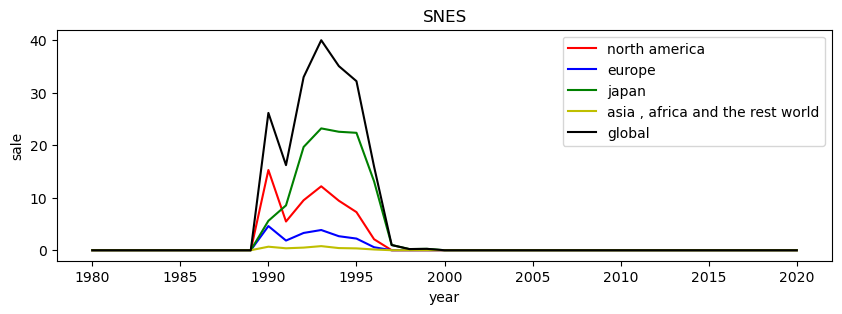

...

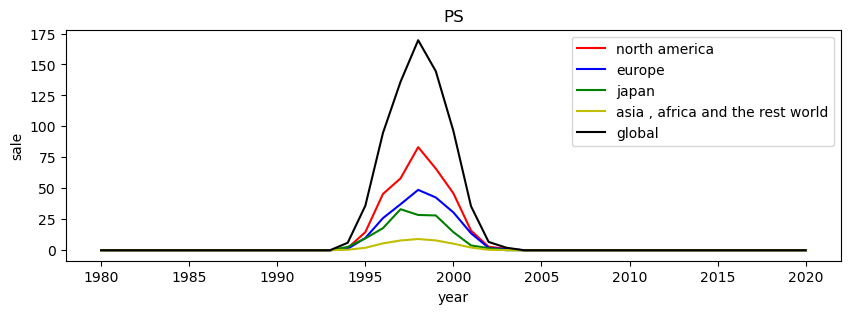

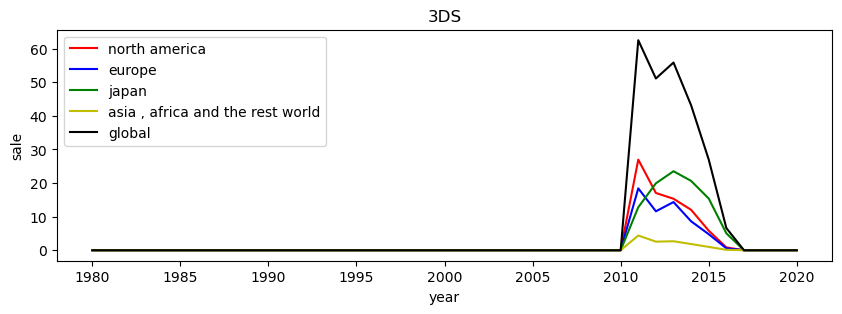

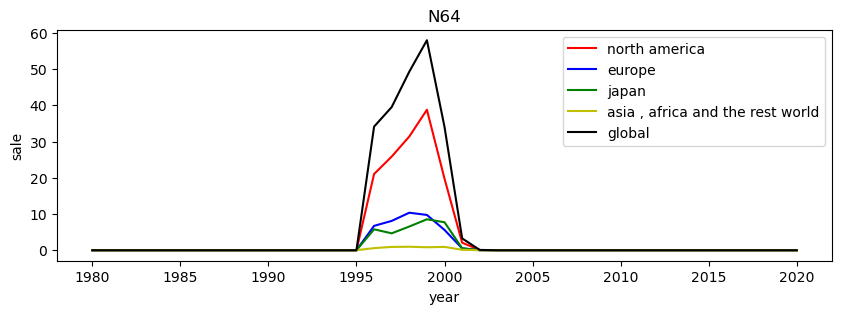

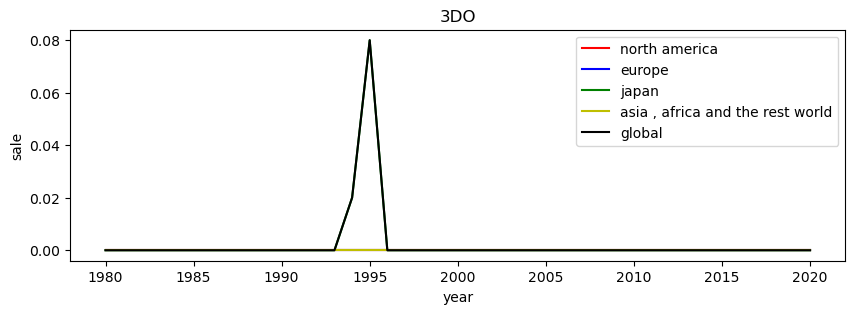

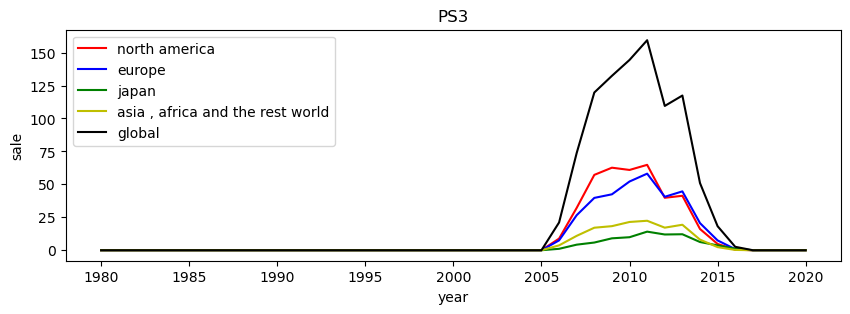

In [33]:
#total sales per platform over time by a plot
x = list(set(finall_df['Year']))
platforms = list(set(finall_df['Platform']))
na = []
eu = []
jp = []
other = []
gl = []
for i in platforms :
    temp_df = finall_df[finall_df['Platform']==i]
    for j in x :
        temp_2 = temp_df[temp_df['Year']==j]
        na.append((i,j,sum(temp_2['NA_Sales'])))
        eu.append((i,j,sum(temp_2['EU_Sales'])))
        jp.append((i,j,sum(temp_2['JP_Sales'])))
        other.append((i,j,sum(temp_2['Other_Sales'])))
        gl.append((i,j,sum(temp_2['Global_Sales'])))
c = 0
for i in platforms :
    plt.figure(figsize=(10,3))
    plt.plot(x,[j[2] for j in na if j[0]==i],'r')
    plt.plot(x,[k[2] for k in eu if k[0]==i],'blue')
    plt.plot(x,[l[2] for l in jp if l[0]==i],'g')
    plt.plot(x,[p[2] for p in other if p[0]==i],'y')
    plt.plot(x,[o[2] for o in gl if o[0]==i],'black')
    plt.xlabel('year')
    plt.ylabel('sale')
    plt.title(f'{i}')
    plt.legend(['north america','europe','japan','asia , africa and the rest world','global'])
    plt.show()

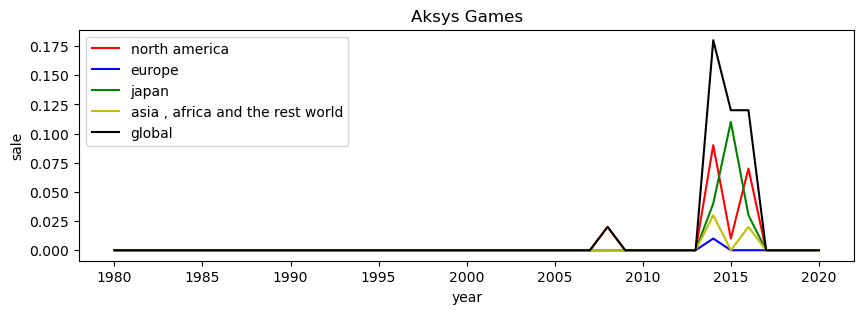

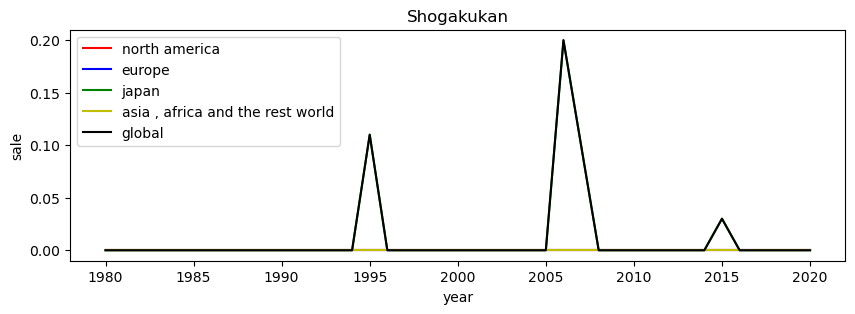

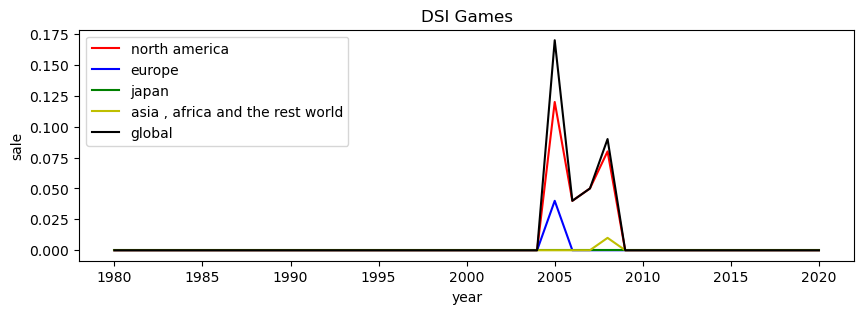

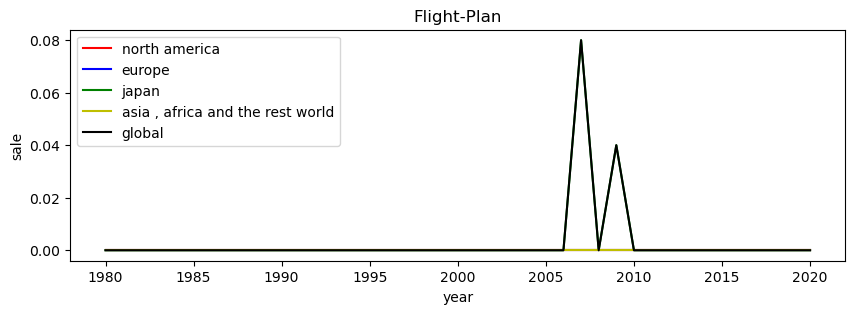

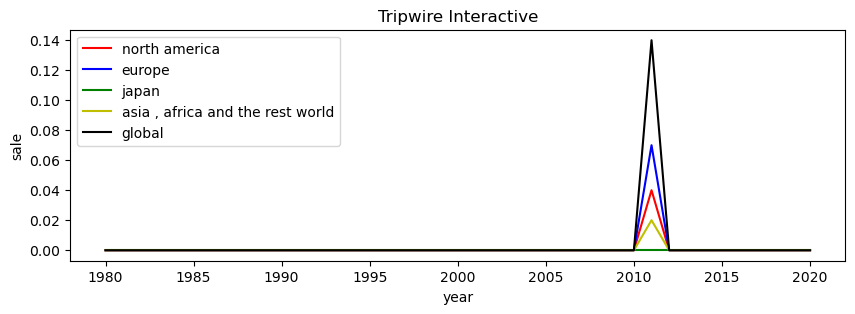

...

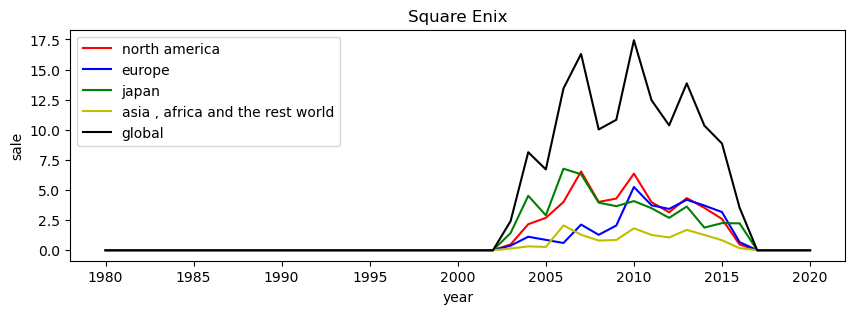

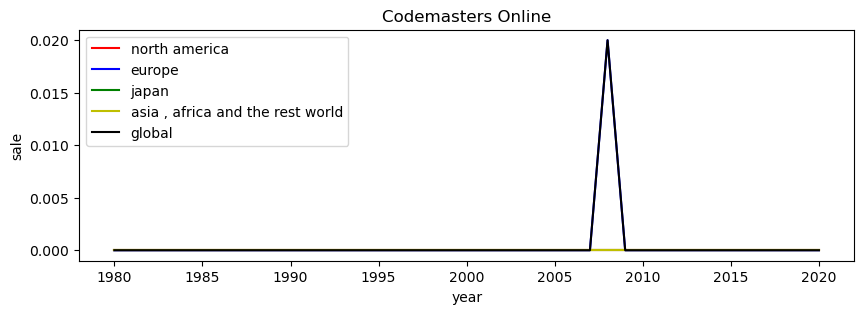

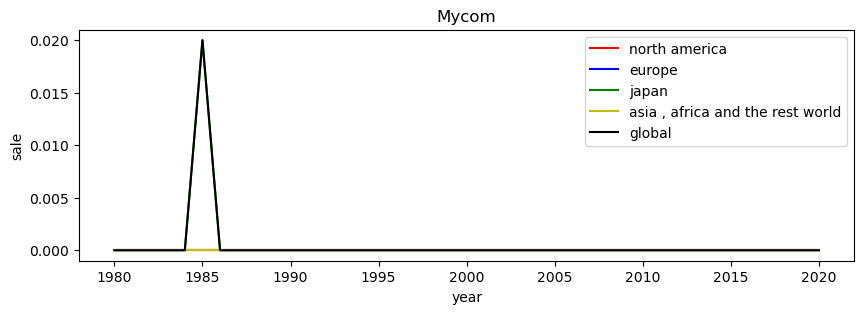

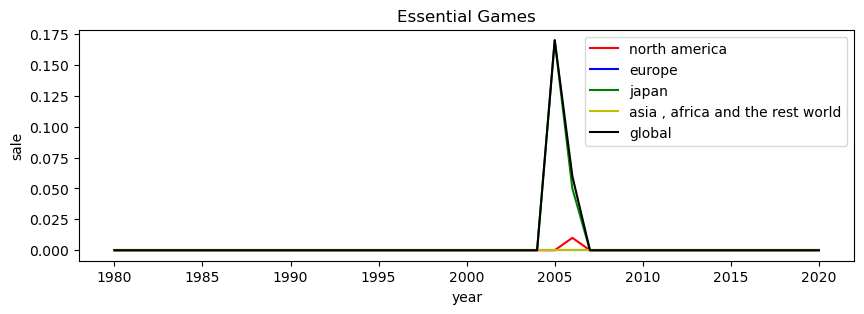

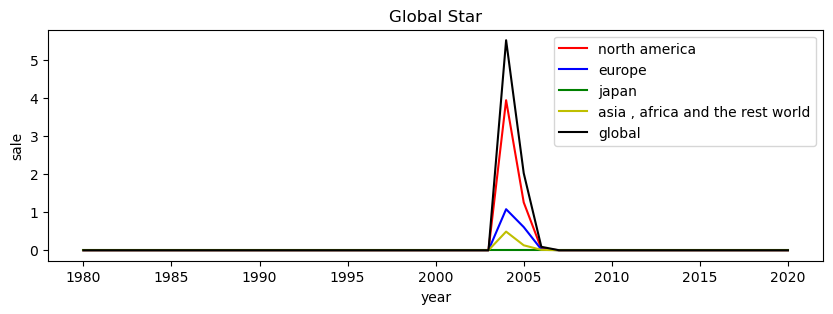

In [34]:
#total sales per publisher over time by a plot
x = list(set(finall_df['Year']))
platforms = list(set(finall_df['publisher']))
na = []
eu = []
jp = []
other = []
gl = []
for i in platforms :
    temp_df = finall_df[finall_df['publisher']==i]
    for j in x :
        temp_2 = temp_df[temp_df['Year']==j]
        na.append((i,j,sum(temp_2['NA_Sales'])))
        eu.append((i,j,sum(temp_2['EU_Sales'])))
        jp.append((i,j,sum(temp_2['JP_Sales'])))
        other.append((i,j,sum(temp_2['Other_Sales'])))
        gl.append((i,j,sum(temp_2['Global_Sales'])))
c = 0
for i in platforms :
    plt.figure(figsize=(10,3))
    plt.plot(x,[j[2] for j in na if j[0]==i],'r')
    plt.plot(x,[k[2] for k in eu if k[0]==i],'blue')
    plt.plot(x,[l[2] for l in jp if l[0]==i],'g')
    plt.plot(x,[p[2] for p in other if p[0]==i],'y')
    plt.plot(x,[o[2] for o in gl if o[0]==i],'black')
    plt.xlabel('year')
    plt.ylabel('sale')
    plt.title(f'{i}')
    plt.legend(['north america','europe','japan','asia , africa and the rest world','global'])
    plt.show()

In [35]:
#finding most famous games , platforms , genres and publishers by each region 
regions = ['NA_Sales','EU_Sales','JP_Sales','Other_Sales']
vals = ['Name','Platform','Genre','publisher']
games = list()
sale_list = list()
sale = 0
for i in regions :
    if i == 'NA_Sales' :
        print('* north america report *')
    elif i == 'EU_Sales' :
        print('* europe report *')
    elif i == 'JP_Sales' :
        print('* japan report *')
    else :
        print('* asia , africa , southern america and the rest world *') 
    for j in vals :
        for k in set(finall_df[j]) :
            temp_df = finall_df[finall_df[j]==k]
            for l in temp_df[i] :
                sale += l
            sale_list.append(sale)
            games.append((k,sale))
            sale = 0
        M = max(sale_list)
        for h in games :
            if h[1] == M :
                if i == 'NA_Sales' :
                    print(f'most famous game {j} in north amercia is {h[0]} from {from_year} to {to_year}')
                    games = []
                    sale_list = []
                    sale = 0
                    break
                elif  i == 'EU_Sales' :
                    print(f'most famous game {j} in europe is {h[0]} from {from_year} to {to_year}')
                    games = []
                    sale_list = []
                    sale = 0
                    break
                elif i == 'JP_Sales' :
                    print(f'most famous game {j} in japan is {h[0]} from {from_year} to {to_year}')
                    games = []
                    sale_list = []
                    sale = 0
                    break
                else :
                    print(f'most famous game {j} in asia , africa , southern america and the rest world is {h[0]} from {from_year} to {to_year}')
                    games = []
                    sale_list = []
                    sale = 0
                    break
    print(f'\n--------------------------------------------------')

* north america report *
most famous game Name in north amercia is Wii Sports from 1980 to 2020
most famous game Platform in north amercia is X360 from 1980 to 2020
most famous game Genre in north amercia is Action from 1980 to 2020
most famous game publisher in north amercia is Nintendo from 1980 to 2020

--------------------------------------------------
* europe report *
most famous game Name in europe is Wii Sports from 1980 to 2020
most famous game Platform in europe is PS3 from 1980 to 2020
most famous game Genre in europe is Action from 1980 to 2020
most famous game publisher in europe is Nintendo from 1980 to 2020

--------------------------------------------------
* japan report *
most famous game Name in japan is Pokemon Red/Pokemon Blue from 1980 to 2020
most famous game Platform in japan is DS from 1980 to 2020
most famous game Genre in japan is Role-Playing from 1980 to 2020
most famous game publisher in japan is Nintendo from 1980 to 2020

--------------------------------

In [36]:
#total each year sales report from 1980 to 2020 by each region and global
regions = ['NA_Sales','EU_Sales','JP_Sales','Other_Sales','Global_Sales']
years = list()
sale = 0
for i in set(finall_df['Year']) :
    temp_df = finall_df[finall_df['Year']==i]
    for j in regions :
        for k in temp_df[j] :
            sale += k
        years.append((i,sale,j))
        sale = 0
new_region = []
years_df = pd.DataFrame(years,columns=['year','sale(in million)','region'])
for i in years_df['region'] :
    if i == 'NA_Sales' :
        new_region.append('north america')
    elif i == 'EU_Sales' :
        new_region.append('europe')
    elif i == 'JP_Sales' :
        new_region.append('japan')
    elif i == 'Other_Sales' :
        new_region.append('asia , africa and the rest world')
    else :
        new_region.append('global')
years_df = years_df.drop(['region'],axis=1)
years_df['region'] = pd.DataFrame(new_region,columns=['region'])
while ask:=input('enter year to see the result (it must be between 1980 to 2020):') :
    if 1980<=int(ask)<=2020 :
        print(years_df[years_df['year']==int(ask)])
        print('\n---------------------------')
    else :
        print('invalid input')
        break

enter year to see the result (it must be between 1980 to 2020):1983
      year  sale(in million)                            region
15  1983.0              7.76                     north america
16  1983.0              0.80                            europe
17  1983.0              8.10                             japan
18  1983.0              0.14  asia , africa and the rest world
19  1983.0             16.79                            global

---------------------------
enter year to see the result (it must be between 1980 to 2020):2000
       year  sale(in million)                            region
100  2000.0             94.49                     north america
101  2000.0             52.75                            europe
102  2000.0             42.77                             japan
103  2000.0             11.62  asia , africa and the rest world
104  2000.0            201.56                            global

---------------------------
enter year to see the result (it must be bet

In [37]:
#most famous games , platforms , genres and publisher by each year from 1980 to 2020 (part 1)
vals = ['Name','Platform','Genre','publisher']
games = list()
platforms = list()
genres = list()
publisher = list()
na_sale = 0
eu_sale = 0
jp_sale = 0
other_sale = 0
gl_sale = 0
for i in set(finall_df['Year']) :
    temp_df = finall_df[finall_df['Year']==i]
    for j in vals :
        for k in set(temp_df[j]):
            new_temp = temp_df[temp_df[j]==k]
            na_sale += sum(new_temp['NA_Sales'])
            eu_sale += sum(new_temp['EU_Sales'])
            jp_sale += sum(new_temp['JP_Sales'])
            other_sale += sum(new_temp['Other_Sales'])
            gl_sale += sum(new_temp['Global_Sales'])
            if j == 'Name' :
                games.append((i,k,na_sale,eu_sale,jp_sale,other_sale,gl_sale))
                na_sale = 0
                eu_sale = 0
                jp_sale = 0
                other_sale = 0
                gl_sale = 0
            elif j == 'Platform' :
                platforms.append((i,k,na_sale,eu_sale,jp_sale,other_sale,gl_sale))
                na_sale = 0
                eu_sale = 0
                jp_sale = 0
                other_sale = 0
                gl_sale = 0
            elif j == 'Genre' :
                genres.append((i,k,na_sale,eu_sale,jp_sale,other_sale,gl_sale))
                na_sale = 0
                eu_sale = 0
                jp_sale = 0
                other_sale = 0
                gl_sale = 0
            else :
                publisher.append((i,k,na_sale,eu_sale,jp_sale,other_sale,gl_sale))
                na_sale = 0
                eu_sale = 0
                jp_sale = 0
                other_sale = 0
                gl_sale = 0
games_df = pd.DataFrame(games,columns=['year','game name','norh america sale','europe sale','japan sale','other countries sale','global sale'])
platform_df = pd.DataFrame(platforms,columns=['year','platform name','norh america sale','europe sale','japan sale','other countries sale','global sale'])
genre_df = pd.DataFrame(genres,columns=['year','genre','norh america sale','europe sale','japan sale','other countries sale','global sale'])
pub_df = pd.DataFrame(publisher,columns=['year','publisher name','norh america sale','europe sale','japan sale','other countries sale','global sale'])

In [38]:
#most famous games , platforms , genres and publisher by each year from 1980 to 2020 (part 2)
vals = ['norh america sale','europe sale','japan sale','other countries sale','global sale']
def showinfo(Y)-> str :
    '''function docstring'''
    if 1980<=Y<=2020 :
        temp_game = games_df[games_df['year']==Y]
        temp_platform = platform_df[platform_df['year']==Y]
        temp_genre = genre_df[genre_df['year']==Y]
        temp_pub = pub_df[pub_df['year']==Y]
        temp_list = ['temp_game','temp_platform','temp_genre','temp_pub']
        for i in vals :
            for j in temp_list :
                if j == 'temp_game' :
                    M = max(temp_game[i])
                    DF = temp_game[temp_game[i]==M]
                    yield f'most famous game in {Y} in {i} is : \n{DF["game name"]}'
                elif j == 'temp_platform' :
                    M = max(temp_platform[i])
                    DF = temp_platform[temp_platform[i]==M]
                    yield f'most famous platform in {Y} in {i} is : \n{DF["platform name"]}'
                elif j == 'temp_genre' :
                    M = max(temp_genre[i])
                    DF = temp_genre[temp_genre[i]==M]
                    yield f'most famous genre in {Y} in {i} is : \n{DF["genre"]}'
                else :
                    M = max(temp_pub[i])
                    DF = temp_pub[temp_pub[i]==M]
                    yield f'most famous publisher in {Y} in {i} is : \n{DF["publisher name"]}'
            print('\n---------------------------------------------------------\n')
    else :
        return 'invalid input'
while ask := input('enter year to see the result (it must be between 1980 to 2020):') :
        int_ask = int(ask)
        for i in showinfo(int_ask) :
            print(i)

enter year to see the result (it must be between 1980 to 2020):2000
most famous game in 2000 in norh america sale is : 
2184    Madden NFL 2001
Name: game name, dtype: object
most famous platform in 2000 in norh america sale is : 
93    PS
Name: platform name, dtype: object
most famous genre in 2000 in norh america sale is : 
192    Sports
Name: genre, dtype: object
most famous publisher in 2000 in norh america sale is : 
608    Electronic Arts
Name: publisher name, dtype: object

---------------------------------------------------------

most famous game in 2000 in europe sale is : 
2201    Driver 2
Name: game name, dtype: object
most famous platform in 2000 in europe sale is : 
93    PS
Name: platform name, dtype: object
most famous genre in 2000 in europe sale is : 
185    Action
Name: genre, dtype: object
most famous publisher in 2000 in europe sale is : 
594    Sony Computer Entertainment
Name: publisher name, dtype: object

--------------------------------------------------------